# 1. Introduction

In [ ]:
# TODO images bigger again
# TODO more complex model
# TODO batch size
# TODO use pretrained model
# TODO data augmentation
# TODO no subset anymore full dataset
# TODO at which point to use the BRISQUE scores? And how to use them?
# TODO maybe again look at the BRISQUE scores and the bins that I calculate from them
# TODO when to create the augmentation regarding data quality from BRISQUE scores?
# TODO do I already want to use that in the training? Or later during calibration?
# TODO what to do next? Also have evaluation in mind where I need to evaluate each aspect of my method!
# TODO so first maybe clearly describe my method with each step! This can go in the introduction!
# TODO different models and save them and also visualization etc.!
# TODO I have to save the images also because of random padding!

# TODO to avoid abrupt changes in prediction sets, we map the BRISQUE bin thresholds to a continuous scale/function

# 2. Setup and Imports

In [2]:
import os
import random
from collections import defaultdict

import numpy as np
import pandas as pd

import torch
from tqdm import tqdm
from PIL import Image, ImageOps
from brisque.brisque import BRISQUE
from sklearn.model_selection import train_test_split

import seaborn as sns
import matplotlib.pyplot as plt

import warnings
warnings.filterwarnings("ignore")

In [3]:
TARGET_SIZE = (448, 448)

random.seed(42)
np.random.seed(42)
torch.manual_seed(42)
if torch.cuda.is_available():
    torch.cuda.manual_seed_all(42)

# 3. Data Loading

In this section, we load all images from the FGSCM-52 dataset, storing them in arrays for further processing and analysis.

In [4]:
# Path to your dataset root (update as needed)
DATA_DIR = './data/'

# Initialize lists
X = []
y = []
paths = []

# Loop through class folders
labels = sorted([d for d in os.listdir(DATA_DIR) if os.path.isdir(os.path.join(DATA_DIR, d))])
print(f"Found {len(labels)} classes:")

for class_name in labels:
    class_path = os.path.join(DATA_DIR, class_name)
    img_files = [f for f in os.listdir(class_path) if f.lower().endswith(('.jpg','.jpeg','.png','.bmp','.tif','.tiff'))]
    for img_file in tqdm(img_files, desc=f"Loading {class_name}"):
        img_path = os.path.join(class_path, img_file)
        try:
            img = Image.open(img_path).convert('RGB')
            X.append(img)
            y.append(class_name)
            paths.append(img_path)
        except Exception as e:
            print(f"Could not load {img_path}: {e}")

print(f"\nLoaded {len(X)} images.")

Found 52 classes:


Loading 017.Lzumo-class_helicopter_destroyer: 100%|██████████| 101/101 [00:00<00:00, 433.14it/s]
Loading 018.Whitby_Island-class_dock_landing_ship: 100%|██████████| 278/278 [00:00<00:00, 611.34it/s]
Loading 038.Atago-class_destroyer: 100%|██████████| 18/18 [00:00<00:00, 521.38it/s]
Loading 039.Mistral-class_amphibious_assault_ship: 100%|██████████| 5/5 [00:00<00:00, 418.25it/s]
Loading 040.Juan_Carlos_I_Strategic_Projection_Ship: 100%|██████████| 12/12 [00:00<00:00, 357.20it/s]
Loading 045.Ford-class aircraft carriers: 100%|██████████| 42/42 [00:00<00:00, 899.97it/s]
Loading 046.Whidbey island-class dock landing ship: 100%|██████████| 611/611 [00:00<00:00, 2650.61it/s]
Loading 051.Asahi-class destroyer: 100%|██████████| 22/22 [00:00<00:00, 11574.85it/s]
Loading 052.America-class_amphibious_assault_ship: 100%|██████████| 58/58 [00:00<00:00, 1776.90it/s]


Loaded 9562 images.


In [5]:
# Print all unique labels and their distribution
label_counts = pd.Series(y).value_counts()
print("\nLabel distribution:")
print(label_counts)


Label distribution:
029.Towing_vessel                              778
030.Civil_yacht                                777
046.Whidbey island-class dock landing ship     611
008.Ticonderoga-class_cruiser                  607
009.Arleigh_Burke-class_destroyer              580
001.Nimitz-class_aircraft_carrier              553
028.Container_ship                             455
014.Wasp-class_assault_ship                    453
019.San_Antonio-class_transport_dock           419
026.Cargo_ship                                 378
049.Tarawa Amphibious Assault Ship             371
031.Medical_ship                               322
018.Whitby_Island-class_dock_landing_ship      278
048.Oliver Hazard Perry class frigate          260
032.Sand_carrier                               226
021.Independence-class_combat_ship             210
003.Midway-class_aircraft_carrier              208
025.Megayacht                                  186
020.Freedom-class_combat_ship                  177
013.Type_4

In [6]:
superclass_map = {
    # Aircraft carriers
    '001.Nimitz-class_aircraft_carrier': 'Carrier',
    '002.KittyHawk-class_aircraft_carrier': 'Carrier',
    '003.Midway-class_aircraft_carrier': 'Carrier',
    '004.Kuznetsov-class_aircraft_carrier': 'Carrier',
    '005.Charles_de_Gaulle_aricraft_carrier': 'Carrier',
    '006.INS_Virrat_aircraft_carrier': 'Carrier',
    '007.INS_Vikramaditya_aircraft_carrier': 'Carrier',
    '034.Garibaldi_aircraft_carrier': 'Carrier',
    '045.Ford-class aircraft carriers': 'Carrier',
    
    # Destroyers
    '009.Arleigh_Burke-class_destroyer': 'Destroyer',
    '010.Akizuki-class_destroyer': 'Destroyer',
    '011.Asagiri-class_destroyer': 'Destroyer',
    '012.Kidd-class_destroyer': 'Destroyer',
    '013.Type_45_destroyer': 'Destroyer',
    '021.Independence-class_combat_ship': 'Destroyer',
    '020.Freedom-class_combat_ship': 'Destroyer',
    '027.Murasame-class_destroyer': 'Destroyer',
    '036.Kongo-class_destroyer': 'Destroyer',
    '037.Horizon-class_destroyer': 'Destroyer',
    '044.Hatsuyuki Class Destroyer': 'Destroyer',
    '047.Hobart Class Destroyer': 'Destroyer',
    '050.Sovremenny-class destroyer': 'Destroyer',
    '051.Asahi-class destroyer': 'Destroyer',
    '035.Zumwalt-class_destroyer': 'Destroyer',
    '017.Lzumo-class_helicopter_destroyer': 'Destroyer',
    '016.Hyuga-class_helicopter_destroyer': 'Destroyer',
    '038.Atago-class_destroyer': 'Destroyer',
    
    # Frigates
    '024.Abukuma-class_frigate': 'Frigate',
    '041.Maestrale-class_frigate': 'Frigate',
    '043.Aquitaine-class frigate': 'Frigate',
    '048.Oliver Hazard Perry class frigate': 'Frigate',
    
    # Cruisers
    '008.Ticonderoga-class_cruiser': 'Cruiser',
    
    # Amphibious/Assault/Dock Landing
    '014.Wasp-class_assault_ship': 'Amphibious',
    '039.Mistral-class_amphibious_assault_ship': 'Amphibious',
    '049.Tarawa Amphibious Assault Ship': 'Amphibious',
    '018.Whitby_Island-class_dock_landing_ship': 'Amphibious',
    '046.Whidbey island-class dock landing ship': 'Amphibious',
    '042.San_Giorgio-class_transport_dock': 'Amphibious',
    '019.San_Antonio-class_transport_dock': 'Amphibious',
    '015.Osumi-class_landing_ship': 'Amphibious',
    '052.America-class_amphibious_assault_ship': 'Amphibious',
    '040.Juan_Carlos_I_Strategic_Projection_Ship': 'Amphibious',
    
    # Support/Medical
    '022.Sacramento-class_support_ship': 'Support',
    '031.Medical_ship': 'Support',
    '023.Crane_ship': 'Support',
    
    # Civilian & Commercial
    '025.Megayacht': 'Civil',
    '030.Civil_yacht': 'Civil',
    '028.Container_ship': 'Civil',
    '026.Cargo_ship': 'Civil',
    '032.Sand_carrier': 'Civil',
    '033.Tank_ship': 'Civil',
    '029.Towing_vessel': 'Civil',
    
    # Others / ambiguous (fallback)
}

# Fill unmapped labels with their fine-grained class if not covered above
unique_labels = set(y)
for lbl in unique_labels:
    if lbl not in superclass_map:
        print(f"Warning: No superclass mapping for label '{lbl}'. Using 'Other'.")
        superclass_map[lbl] = 'Other'

# Create new label list for superclasses
super_y = [superclass_map.get(lbl, 'Other') for lbl in y]

# Print new superclass distribution
superclass_counts = pd.Series(super_y).value_counts()
print("Superclass distribution:")
print(superclass_counts)

Superclass distribution:
Civil         2959
Amphibious    2329
Destroyer     1754
Carrier        981
Cruiser        607
Support        514
Frigate        418
Name: count, dtype: int64


# 4. Image Preprocessing: Resizing and Padding

In [7]:
def resize_and_pad(img, target_size=(448, 448)):
    iw, ih = img.size
    tw, th = target_size

    # Scale image so the largest side matches the target size (no cropping)
    scale = min(tw / iw, th / ih)
    new_w, new_h = int(iw * scale), int(ih * scale)
    img_resized = img.resize((new_w, new_h), Image.LANCZOS)
    
    # Compute padding needed on each side
    pad_w = tw - new_w
    pad_h = th - new_h
    
    # Make padding equal on both sides
    left = pad_w // 2
    right = pad_w - left
    top = pad_h // 2
    bottom = pad_h - top
    
    padding = (left, top, right, bottom)
    img_padded = ImageOps.expand(img_resized, padding, fill=(0, 0, 0))
    return img_padded

In [8]:
# Process all images and save new images and superclasses
processed_imgs = []
processed_labels = []

for img, superclass in zip(X, super_y):
    img_proc = resize_and_pad(img, TARGET_SIZE)
    processed_imgs.append(img_proc)
    processed_labels.append(superclass)

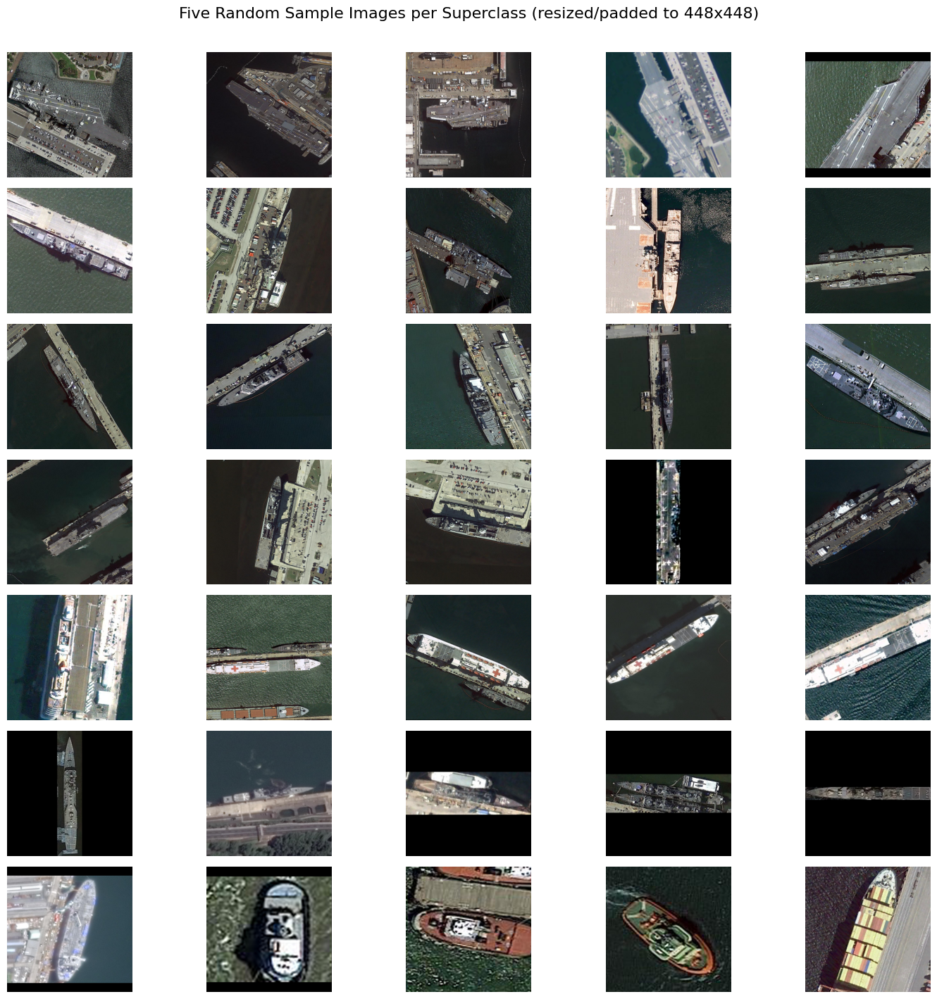

In [9]:
# Group images by superclass
images_by_class = defaultdict(list)
for img, label in zip(processed_imgs, processed_labels):
    images_by_class[label].append(img)

# Randomly sample 5 images per superclass
samples_by_class = {}
for label, imgs in images_by_class.items():
    n_samples = min(5, len(imgs))
    samples_by_class[label] = random.sample(imgs, n_samples)

# Plotting
import matplotlib.pyplot as plt

plt.figure(figsize=(15, 2 * len(samples_by_class)))
for row, (label, imgs) in enumerate(samples_by_class.items()):
    for col, img in enumerate(imgs):
        plt.subplot(len(samples_by_class), 5, row * 5 + col + 1)
        plt.imshow(img)
        plt.axis('off')
        if col == 0:
            plt.ylabel(label, fontsize=12)
plt.suptitle("Five Random Sample Images per Superclass (resized/padded to 448x448)", y=1.01, fontsize=16)
plt.tight_layout()
plt.show()

In [10]:
# Check all processed images have the correct size
correct = True
for idx, img in enumerate(processed_imgs):
    if img.size != TARGET_SIZE:
        print(f"Image at index {idx} has size {img.size}, expected {TARGET_SIZE}")
        correct = False

if correct:
    print(f"All images are {TARGET_SIZE} as expected!")
else:
    print("Some images do not have the correct size.")

All images are (448, 448) as expected!


# 5. Computing Image Quality: BRISQUE Scores

In [ ]:
metadata_path = 'fgscm52_metadata_448.csv'

if not os.path.exists(metadata_path):
    # Create BRISQUE object
    brisque_model = BRISQUE(url=False)

    # Compute BRISQUE scores for all images
    brisque_scores = []
    for img in tqdm(processed_imgs, desc="Computing BRISQUE scores"):
        img_arr = np.asarray(img)
        score = brisque_model.score(img=img_arr)
        score = max(0, min(100, score))
        brisque_scores.append(score)

    # Build metadata DataFrame
    df = pd.DataFrame({
        'img_path': paths,
        'label': processed_labels,
        'brisque': brisque_scores
    })

    # Save metadata DataFrame
    df.to_csv(metadata_path, index=False)
    print(f"Saved metadata to {metadata_path}")
else:
    df = pd.read_csv(metadata_path)
    print(f"Loaded metadata from {metadata_path}")

brisque_scores = np.array(df['brisque'].tolist())
print(f"BRISQUE scores shape: {brisque_scores.shape}")

Loaded metadata from fgscm52_metadata_448.csv
BRISQUE scores shape: (9562,)


# 6. Exploratory Data Analysis (EDA) of Image Quality (BRISQUE Scores)

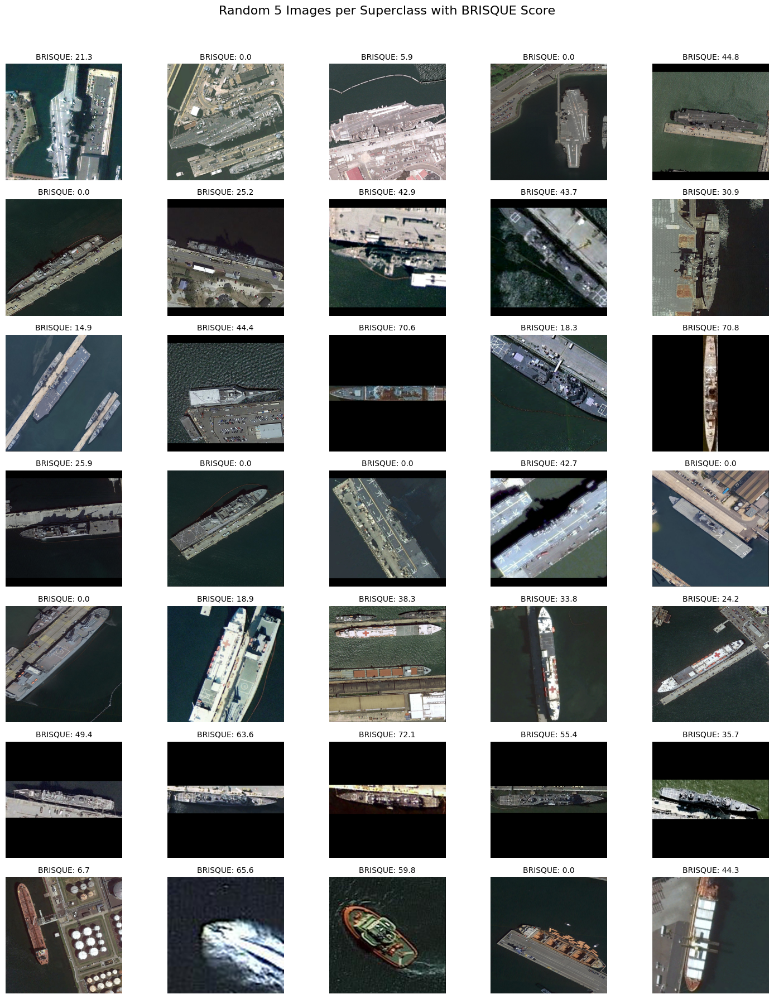

In [13]:
# Create a mapping from path to index in processed_imgs
path_to_idx = {p: i for i, p in enumerate(paths)}

superclasses = df['label'].unique()
plt.figure(figsize=(15, 2.5 * len(superclasses)))
plot_idx = 1

for superclass in superclasses:
    subset = df[df['label'] == superclass]
    if len(subset) == 0:
        continue
    sample_rows = subset.sample(min(5, len(subset)))
    for i, row in enumerate(sample_rows.itertuples()):
        idx = path_to_idx[row.img_path]
        img = processed_imgs[idx]
        plt.subplot(len(superclasses), 5, plot_idx)
        plt.imshow(img)
        plt.axis('off')
        plt.title(f"BRISQUE: {row.brisque:.1f}", fontsize=10)
        if i == 0:
            plt.ylabel(superclass, fontsize=12)
        plot_idx += 1

plt.suptitle("Random 5 Images per Superclass with BRISQUE Score", y=1.02, fontsize=16)
plt.tight_layout()
plt.show()

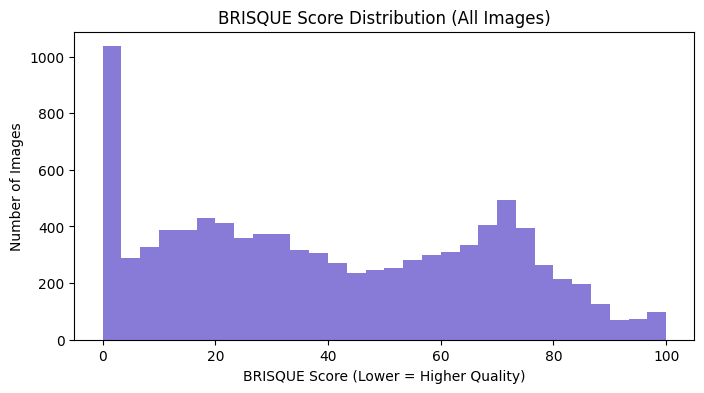

In [14]:
plt.figure(figsize=(8,4))
plt.hist(df['brisque'], bins=30, color='slateblue', alpha=0.8)
plt.title("BRISQUE Score Distribution (All Images)")
plt.xlabel("BRISQUE Score (Lower = Higher Quality)")
plt.ylabel("Number of Images")
plt.show()

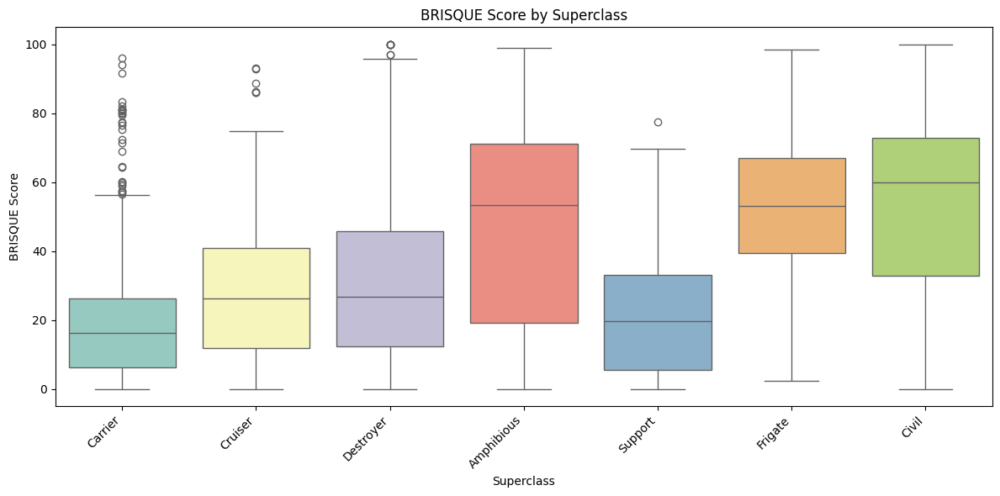

In [15]:
plt.figure(figsize=(12, 6))
sns.boxplot(x='label', y='brisque', data=df, palette="Set3")
plt.xticks(rotation=45, ha='right')
plt.title("BRISQUE Score by Superclass")
plt.xlabel("Superclass")
plt.ylabel("BRISQUE Score")
plt.tight_layout()
plt.show()

In [16]:
class_stats = df.groupby('label')['brisque'].describe()[['count','mean','std','min','25%','50%','75%','max']]
print(class_stats)

             count       mean        std       min        25%        50%  \
label                                                                      
Amphibious  2329.0  45.631385  29.037352  0.000000  19.248955  53.276621   
Carrier      981.0  18.631589  16.353245  0.000000   6.266085  16.326580   
Civil       2959.0  53.409592  26.407191  0.000000  32.811281  59.977381   
Cruiser      607.0  27.601400  19.290770  0.000000  11.910563  26.259487   
Destroyer   1754.0  31.783389  25.186881  0.000000  12.294427  26.730379   
Frigate      418.0  52.428072  19.338640  2.245296  39.387669  53.174407   
Support      514.0  21.393227  17.628753  0.000000   5.631308  19.631624   

                  75%         max  
label                              
Amphibious  71.192811   99.056215  
Carrier     26.246057   96.098195  
Civil       72.859276  100.000000  
Cruiser     40.902644   93.096107  
Destroyer   45.882161  100.000000  
Frigate     66.955465   98.579764  
Support     33.110479   77.

# 7. Stratified Train/validation(Calibration)/Test Split

In [76]:
# First split off the test set (20%)
trainval_df, test_df = train_test_split(
    df, test_size=0.2, stratify=df['label'], random_state=42
)

# Now split trainval into train and validation so that validation is 20% of the full set
# Validation size relative to trainval: 0.2 / 0.8 = 0.25
train_df, val_df = train_test_split(
    trainval_df, test_size=0.25/0.8, stratify=trainval_df['label'], random_state=42
)

print(f"Train set: {len(train_df)} images")
print(f"Validation/Calibration set: {len(val_df)} images")
print(f"Test set: {len(test_df)} images")

Train set: 5258 images
Validation/Calibration set: 2391 images
Test set: 1913 images


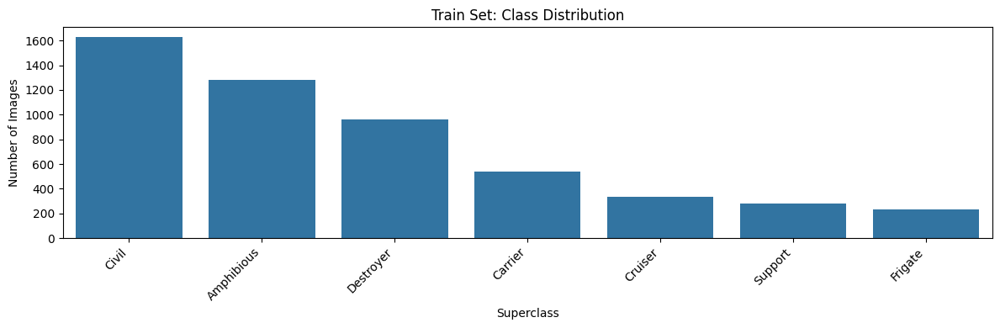

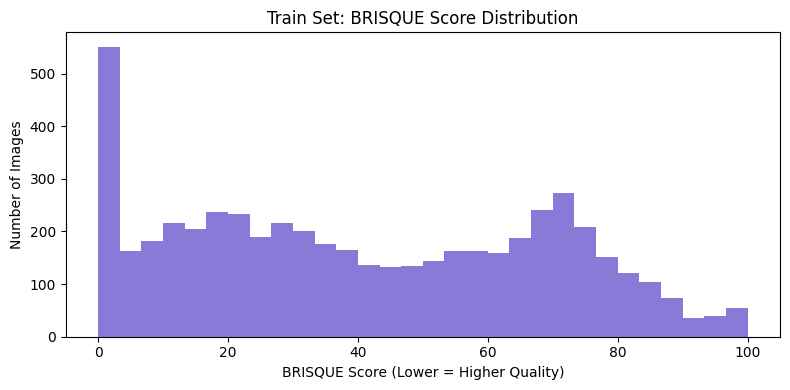

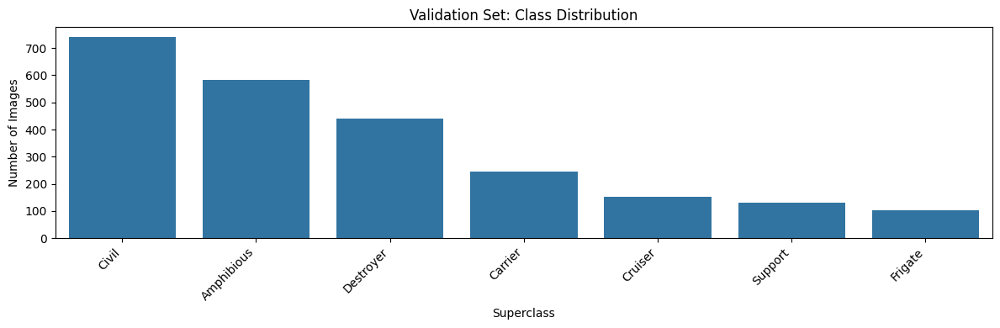

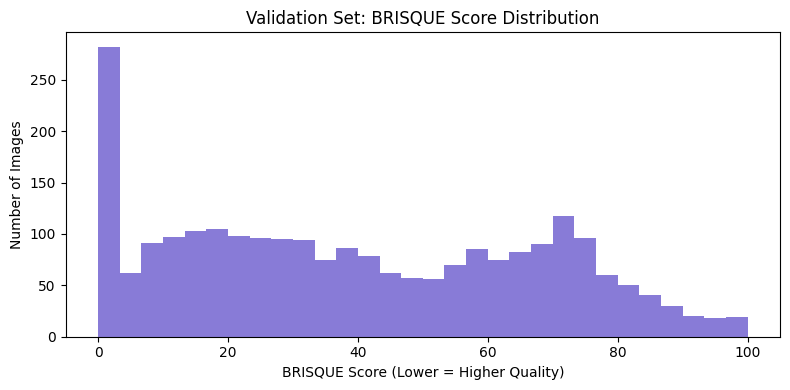

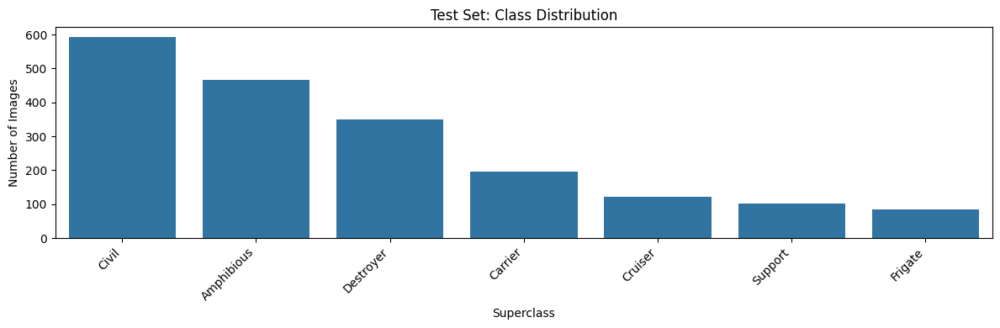

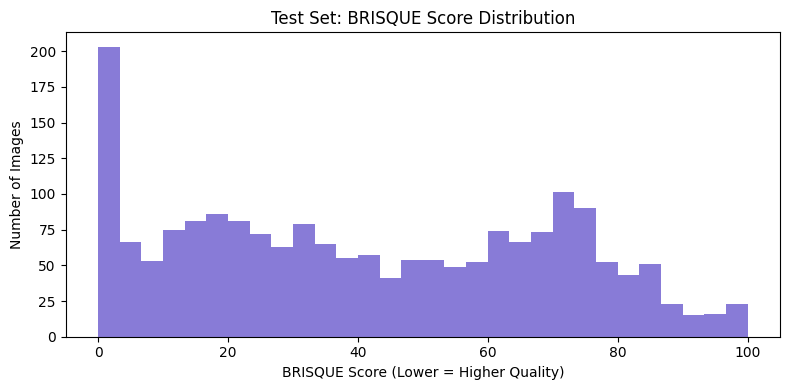

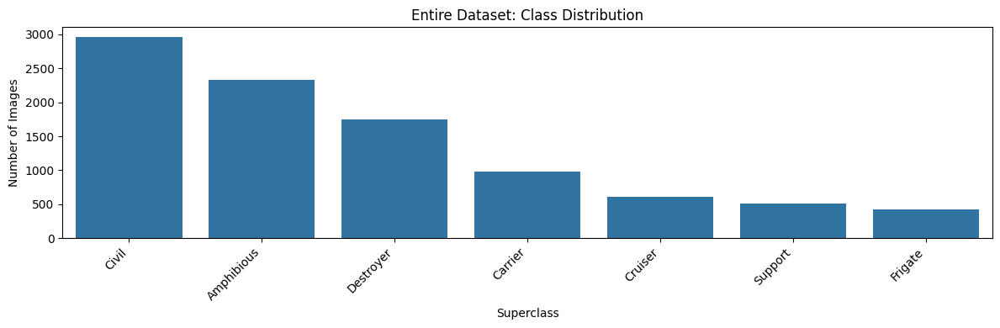

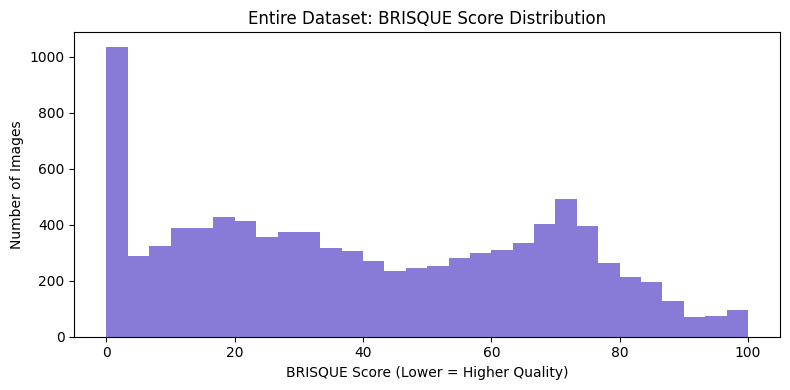

In [78]:
# Plot for each split
splits = [
    ("Train", train_df),
    ("Validation", val_df),
    ("Test", test_df)
]

for split_name, split_df in splits:
    plt.figure(figsize=(12, 4))
    sns.countplot(x='label', data=split_df, order=split_df['label'].value_counts().index)
    plt.xticks(rotation=45, ha='right')
    plt.title(f"{split_name} Set: Class Distribution")
    plt.xlabel("Superclass")
    plt.ylabel("Number of Images")
    plt.tight_layout()
    plt.show()

    plt.figure(figsize=(8, 4))
    plt.hist(split_df['brisque'], bins=30, color='slateblue', alpha=0.8)
    plt.title(f"{split_name} Set: BRISQUE Score Distribution")
    plt.xlabel("BRISQUE Score (Lower = Higher Quality)")
    plt.ylabel("Number of Images")
    plt.tight_layout()
    plt.show()

# Plot for the entire dataset
plt.figure(figsize=(12, 4))
sns.countplot(x='label', data=df, order=df['label'].value_counts().index)
plt.xticks(rotation=45, ha='right')
plt.title("Entire Dataset: Class Distribution")
plt.xlabel("Superclass")
plt.ylabel("Number of Images")
plt.tight_layout()
plt.show()

plt.figure(figsize=(8, 4))
plt.hist(df['brisque'], bins=30, color='slateblue', alpha=0.8)
plt.title("Entire Dataset: BRISQUE Score Distribution")
plt.xlabel("BRISQUE Score (Lower = Higher Quality)")
plt.ylabel("Number of Images")
plt.tight_layout()
plt.show()

# 8. Training and Testing the Classifiers

In [112]:
# Set this to a value like 0.1 for 10% of data, or e.g. 1000 for max 1000 images per split
subset_frac = 1.00  # e.g. 0.1 for 10%, or None to use all data
subset_max = None  # e.g. 1000 for max 1000 images

def get_subset(df, frac=None, max_samples=None, seed=42):
    if frac is not None:
        df = df.sample(frac=frac, random_state=seed)
    if max_samples is not None and len(df) > max_samples:
        df = df.sample(n=max_samples, random_state=seed)
    return df.reset_index(drop=True)

train_sub = get_subset(train_df, frac=subset_frac, max_samples=subset_max)
val_sub   = get_subset(val_df,   frac=subset_frac, max_samples=subset_max)
test_sub  = get_subset(test_df,  frac=subset_frac, max_samples=subset_max)
print(f"Train subset: {len(train_sub)} images, Val: {len(val_sub)}, Test: {len(test_sub)}")

Train subset: 5258 images, Val: 2391, Test: 1913


In [113]:
import torch
from torch.utils.data import Dataset, DataLoader, WeightedRandomSampler
from torchvision import transforms
from PIL import Image
import numpy as np

train_transform = transforms.Compose([
    transforms.Resize((448, 448)),
    transforms.RandomHorizontalFlip(),
    transforms.RandomRotation(degrees=(0, 360)),
    transforms.ColorJitter(brightness=0.3, contrast=0.3, saturation=0.3, hue=0.1),
    transforms.RandomAffine(degrees=0, translate=(0.1,0.1), scale=(0.9,1.1)),
    transforms.ToTensor(),
])

eval_transform = transforms.Compose([
    transforms.Resize((448, 448)),
    transforms.ToTensor(),
])

class ShipDataset(Dataset):
    def __init__(self, df, transform=None):
        self.img_paths = df['img_path'].tolist()
        self.labels = df['label'].astype('category').cat.codes.tolist()
        self.transform = transform

    def __len__(self):
        return len(self.img_paths)

    def __getitem__(self, idx):
        img = Image.open(self.img_paths[idx]).convert('RGB')
        if self.transform:
            img = self.transform(img)
        label = self.labels[idx]
        return img, label

label_names = train_sub['label'].astype('category').cat.categories.tolist()
num_classes = len(label_names)

train_dataset = ShipDataset(train_sub, transform=train_transform)
val_dataset   = ShipDataset(val_sub,   transform=eval_transform)
test_dataset  = ShipDataset(test_sub,  transform=eval_transform)

batch_size = 32
num_workers = 0

# WeightedRandomSampler setup
train_labels = [label for _, label in train_dataset]
class_sample_counts = np.bincount(train_labels)
class_weights = 1.0 / class_sample_counts
sample_weights = np.array([class_weights[label] for label in train_labels])
sampler = WeightedRandomSampler(sample_weights, len(sample_weights), replacement=True)

train_loader = DataLoader(train_dataset, batch_size=batch_size, sampler=sampler, num_workers=num_workers)
val_loader   = DataLoader(val_dataset, batch_size=batch_size, shuffle=False, num_workers=num_workers)
test_loader  = DataLoader(test_dataset, batch_size=batch_size, shuffle=False, num_workers=num_workers)

In [114]:
from torchvision import models
import torch.nn as nn

def get_model(name, num_classes):
    if name == "resnet18":
        model = models.resnet18(pretrained=True)
        model.fc = nn.Linear(model.fc.in_features, num_classes)
    elif name == "resnet50":
        model = models.resnet50(pretrained=True)
        model.fc = nn.Linear(model.fc.in_features, num_classes)
    elif name == "efficientnet_b0":
        model = models.efficientnet_b0(pretrained=True)
        model.classifier[1] = nn.Linear(model.classifier[1].in_features, num_classes)
    elif name == "densenet121":
        model = models.densenet121(pretrained=True)
        model.classifier = nn.Linear(model.classifier.in_features, num_classes)
    elif name == "mobilenet_v3_large":
        model = models.mobilenet_v3_large(pretrained=True)
        model.classifier[3] = nn.Linear(model.classifier[3].in_features, num_classes)
    else:
        raise ValueError(f"Unknown model: {name}")
    return model

In [115]:
import time
import copy

# Class weights for loss function
class_weights_tensor = torch.tensor(class_weights, dtype=torch.float32)

def train_and_validate(model, train_loader, val_loader, num_epochs=5, lr=1e-4, device='cpu', model_name='model'):
    criterion = torch.nn.CrossEntropyLoss(weight=class_weights_tensor.to(device))
    optimizer = torch.optim.Adam(model.parameters(), lr=lr)
    best_acc = 0.0
    best_model_wts = copy.deepcopy(model.state_dict())
    train_hist = []
    val_hist = []

    for epoch in range(num_epochs):
        epoch_start = time.time()
        model.train()
        running_loss, correct, total = 0.0, 0, 0
        for imgs, labels in train_loader:
            imgs, labels = imgs.to(device), labels.to(device)
            optimizer.zero_grad()
            outputs = model(imgs)
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()
            running_loss += loss.item() * imgs.size(0)
            _, predicted = outputs.max(1)
            total += labels.size(0)
            correct += predicted.eq(labels).sum().item()
        train_acc = correct / total
        train_hist.append(train_acc)

        model.eval()
        val_correct, val_total = 0, 0
        with torch.no_grad():
            for imgs, labels in val_loader:
                imgs, labels = imgs.to(device), labels.to(device)
                outputs = model(imgs)
                _, predicted = outputs.max(1)
                val_total += labels.size(0)
                val_correct += predicted.eq(labels).sum().item()
        val_acc = val_correct / val_total
        val_hist.append(val_acc)

        epoch_time = time.time() - epoch_start
        print(f"{model_name} | Epoch {epoch+1}: Train Acc={train_acc:.3f}, Val Acc={val_acc:.3f}, Time: {epoch_time:.1f}s")

        if val_acc > best_acc:
            best_acc = val_acc
            best_model_wts = copy.deepcopy(model.state_dict())

    # Save best model
    model.load_state_dict(best_model_wts)
    torch.save(model.state_dict(), f"{model_name}_best.pth")
    print(f"Saved best {model_name} to {model_name}_best.pth (Val Acc={best_acc:.3f})")
    return model, train_hist, val_hist

In [116]:
from sklearn.metrics import classification_report, confusion_matrix
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

def test_and_report(model, test_loader, label_names, device='cpu', model_name='model'):
    model.eval()
    test_preds, test_labels = [], []
    with torch.no_grad():
        for imgs, labels in test_loader:
            imgs = imgs.to(device)
            outputs = model(imgs)
            _, preds = outputs.max(1)
            test_preds.extend(preds.cpu().numpy())
            test_labels.extend(labels.numpy())
    report = classification_report(test_labels, test_preds, target_names=label_names, output_dict=True)
    print(f"\nTest Results for {model_name}:")
    print(classification_report(test_labels, test_preds, target_names=label_names))
    cm = confusion_matrix(test_labels, test_preds)
    plt.figure(figsize=(10,8))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=label_names, yticklabels=label_names)
    plt.xlabel("Predicted")
    plt.ylabel("True")
    plt.title(f"{model_name}: Confusion Matrix (Test Set)")
    plt.tight_layout()
    plt.show()
    # Save report
    import json
    with open(f"{model_name}_test_report.json", "w") as f:
        json.dump(report, f)
    print(f"Test report saved to {model_name}_test_report.json")
    return report


========== Training mobilenet_v3_large ==========
mobilenet_v3_large | Epoch 1: Train Acc=0.537, Val Acc=0.446, Time: 922.3s
mobilenet_v3_large | Epoch 2: Train Acc=0.790, Val Acc=0.803, Time: 1090.4s
mobilenet_v3_large | Epoch 3: Train Acc=0.880, Val Acc=0.867, Time: 1113.9s
mobilenet_v3_large | Epoch 4: Train Acc=0.921, Val Acc=0.941, Time: 919.6s
mobilenet_v3_large | Epoch 5: Train Acc=0.935, Val Acc=0.908, Time: 940.7s
mobilenet_v3_large | Epoch 6: Train Acc=0.947, Val Acc=0.959, Time: 969.7s
mobilenet_v3_large | Epoch 7: Train Acc=0.967, Val Acc=0.952, Time: 998.0s
mobilenet_v3_large | Epoch 8: Train Acc=0.965, Val Acc=0.963, Time: 870.9s
mobilenet_v3_large | Epoch 9: Train Acc=0.977, Val Acc=0.958, Time: 937.9s
mobilenet_v3_large | Epoch 10: Train Acc=0.971, Val Acc=0.972, Time: 978.6s
Saved best mobilenet_v3_large to mobilenet_v3_large_best.pth (Val Acc=0.972)

Test Results for mobilenet_v3_large:
              precision    recall  f1-score   support

  Amphibious       0.97   

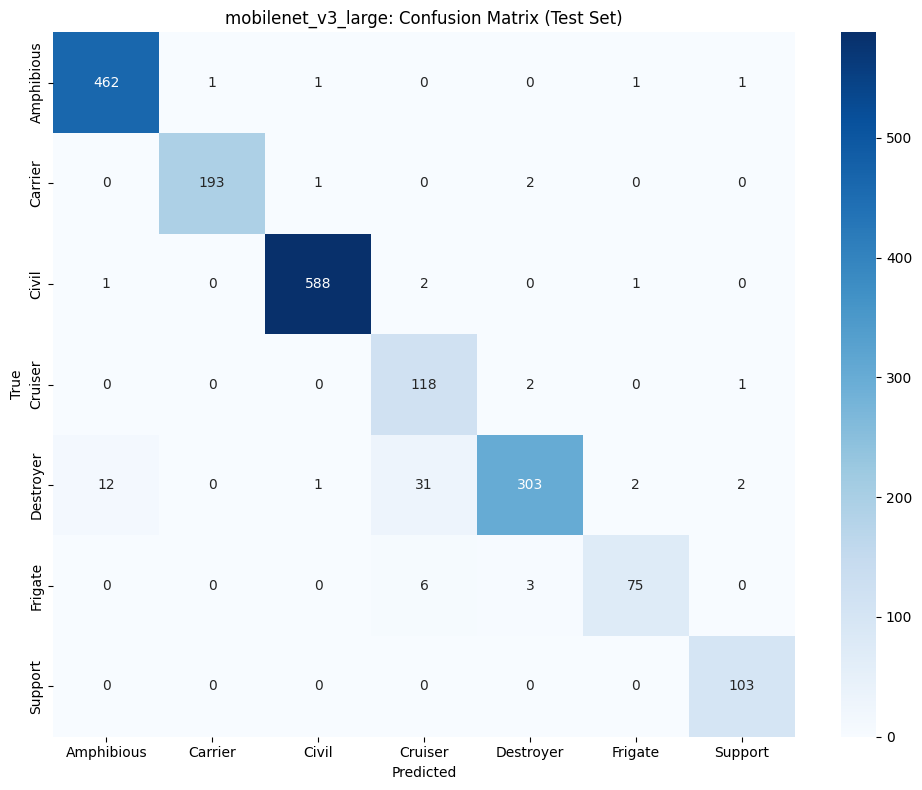

Test report saved to mobilenet_v3_large_test_report.json


In [117]:
device = torch.device("cpu")  # You can set "cuda" if GPU is available

model_names = [
    "mobilenet_v3_large",
    # "resnet18",
    # "efficientnet_b0",
    # "densenet121",
    # "resnet50",
]
all_reports = {}

for name in model_names:
    print(f"\n{'='*10} Training {name} {'='*10}")
    model = get_model(name, num_classes=len(label_names)).to(device)
    model, train_hist, val_hist = train_and_validate(
        model, train_loader, val_loader, num_epochs=10, lr=1e-4, device=device, model_name=name
    )
    report = test_and_report(model, test_loader, label_names, device=device, model_name=name)
    all_reports[name] = report

In [118]:
model_info = {
    # "resnet18":         "resnet18_best.pth",
    # "resnet50":         "resnet50_best.pth",
    # "efficientnet_b0":  "efficientnet_b0_best.pth",
    # "densenet121":      "densenet121_best.pth",
    "mobilenet_v3_large":"mobilenet_v3_large_best.pth"
}

In [127]:
loaded_models = {}
device = torch.device("cpu")
num_classes = len(label_names)  # or set to the correct value for your experiment

for model_name, weight_file in model_info.items():
    # Your get_model should be defined as shown earlier
    model = get_model(model_name, num_classes=num_classes).to(device)
    model.load_state_dict(torch.load(weight_file, map_location=device))
    model.eval()
    loaded_models[model_name] = model
    print(f"Loaded {model_name} from {weight_file}")

Loaded mobilenet_v3_large from mobilenet_v3_large_best.pth


In [128]:
import torch
import pandas as pd
import numpy as np
from PIL import Image
from torchvision import transforms
from collections import OrderedDict

def get_probs_for_df(model, df, label_names, device="cpu", batch_size=1):
    model.eval()
    img_paths = df['img_path'].tolist()
    true_labels = df['label'].tolist()
    brisque_scores = df['brisque'].tolist()
    results = []


    eval_transform = transforms.Compose([
        transforms.Resize((448, 448)),
        transforms.ToTensor(),
    ])

    with torch.no_grad():
        for img_path, label, brisque in zip(img_paths, true_labels, brisque_scores):
            img = Image.open(img_path).convert('RGB')
            img_tensor = eval_transform(img).unsqueeze(0).to(device)
            outputs = model(img_tensor)
            probs = torch.softmax(outputs, dim=1).cpu().numpy().flatten()
            row = {
                "img_path": img_path,
                "label": label,
                "brisque": brisque
            }
            for i, class_name in enumerate(label_names):
                row[f"prob_{class_name}"] = probs[i]
            results.append(row)
    return pd.DataFrame(results)

device = torch.device("cpu")

# Get label names
label_names = train_sub['label'].astype('category').cat.categories.tolist()

# Load model
# model = get_model(model_name, num_classes=num_classes).to(device)
# model.load_state_dict(torch.load(model_info[model_name], map_location=device))
# model.eval()

for model_name, model in loaded_models.items():
    # Validation set
    val_probs_df = get_probs_for_df(model, val_df, label_names, device=device)
    val_probs_df.to_csv(f"{model_name}_val_probs.csv", index=False)
    print(f"Saved validation probabilities to {model_name}_val_probs.csv")

    # Test set
    test_probs_df = get_probs_for_df(model, test_df, label_names, device=device)
    test_probs_df.to_csv(f"{model_name}_test_probs.csv", index=False)
    print(f"Saved test probabilities to {model_name}_test_probs.csv")

Saved validation probabilities to mobilenet_v3_large_val_probs.csv
Saved test probabilities to mobilenet_v3_large_test_probs.csv


In [129]:
import pandas as pd
import os

def compute_accuracy_from_probs(prob_file):
    if not os.path.exists(prob_file):
        print(f"File not found: {prob_file}")
        return None
    df = pd.read_csv(prob_file)
    prob_cols = [c for c in df.columns if c.startswith("prob_")]
    pred_idx = df[prob_cols].values.argmax(axis=1)
    # Map true label to index
    label_names = [c.replace("prob_", "") for c in prob_cols]
    label_to_idx = {name: i for i, name in enumerate(label_names)}
    true_idx = df['label'].map(label_to_idx).values
    accuracy = (pred_idx == true_idx).mean()
    return accuracy

for split_tag in ["val", "test"]:
    prob_file = f"{model_name}_{split_tag}_probs.csv"
    acc = compute_accuracy_from_probs(prob_file)
    if acc is not None:
        print(f"{split_tag.capitalize()} accuracy: {acc:.4f}")

Val accuracy: 0.9720
Test accuracy: 0.9629


# 8. Exploratory Analysis of the Results

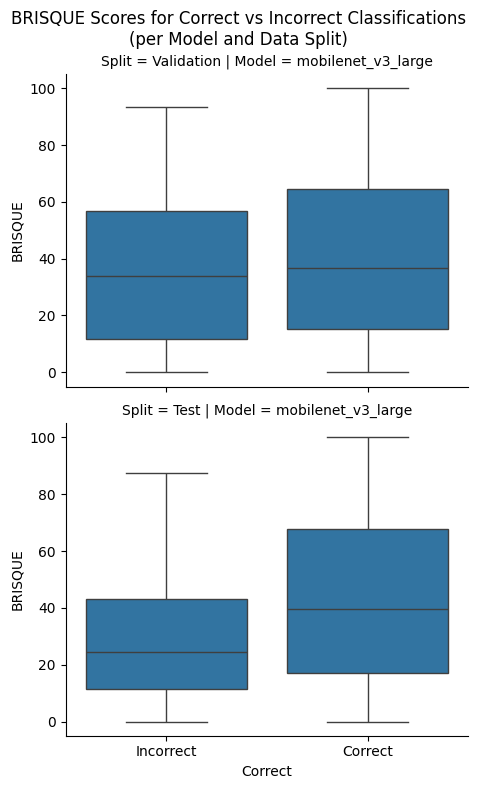

In [130]:
import pandas as pd
import seaborn as sns
import os

import matplotlib.pyplot as plt

# Helper: get all splits and their corresponding dataframes
split_info = [
    ("Validation", val_df, "val"),
    ("Test", test_df, "test"),
]

# Store results for plotting
results = []

for model_name in model_names:
    for split_title, split_df, split_tag in split_info:
        # Load probability file
        prob_file = f"{model_name}_{split_tag}_probs.csv"
        if not os.path.exists(prob_file):
            print(f"File not found: {prob_file}")
            continue
        df_probs = pd.read_csv(prob_file)
        # True label index
        label_to_idx = {name: i for i, name in enumerate(split_df['label'].astype('category').cat.categories)}
        # If label column is categorical, ensure mapping
        if 'label' in df_probs.columns and df_probs['label'].dtype.name == 'category':
            df_probs['label'] = df_probs['label'].astype(str)
        # Get predicted class (argmax of prob columns)
        prob_cols = [c for c in df_probs.columns if c.startswith("prob_")]
        df_probs['pred_idx'] = df_probs[prob_cols].values.argmax(axis=1)
        # True class index
        if 'label' in df_probs.columns:
            df_probs['true_idx'] = df_probs['label'].map(label_to_idx)
        else:
            # fallback: use split_df
            df_probs['true_idx'] = split_df['label'].astype('category').cat.codes.values
        # Correct or not
        df_probs['correct'] = df_probs['pred_idx'] == df_probs['true_idx']
        # Store for plotting
        for correct_val, group in df_probs.groupby('correct'):
            results.append(pd.DataFrame({
                'BRISQUE': group['brisque'],
                'Correct': "Correct" if correct_val else "Incorrect",
                'Model': model_name,
                'Split': split_title
            }))

# Combine all results
plot_df = pd.concat(results, ignore_index=True)

# Plot: BRISQUE score distributions for correct/incorrect, per model and split
g = sns.catplot(
    data=plot_df,
    x="Correct", y="BRISQUE",
    col="Model", row="Split",
    kind="box",
    sharey=True,
    height=4, aspect=1.2
)
g.fig.subplots_adjust(top=0.9)
g.fig.suptitle("BRISQUE Scores for Correct vs Incorrect Classifications\n(per Model and Data Split)")
plt.show()

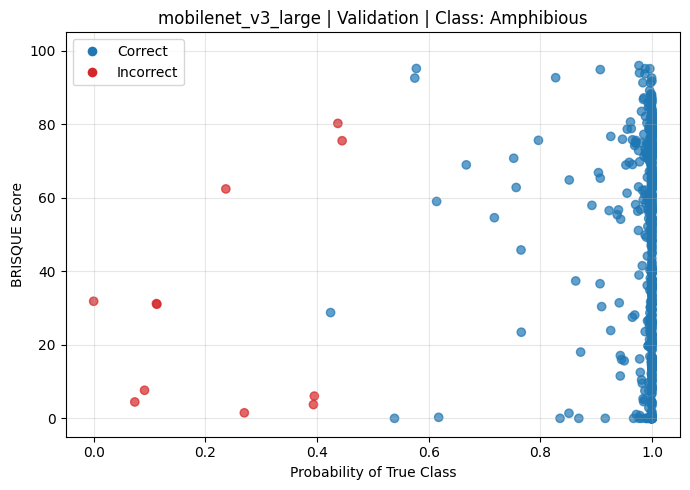

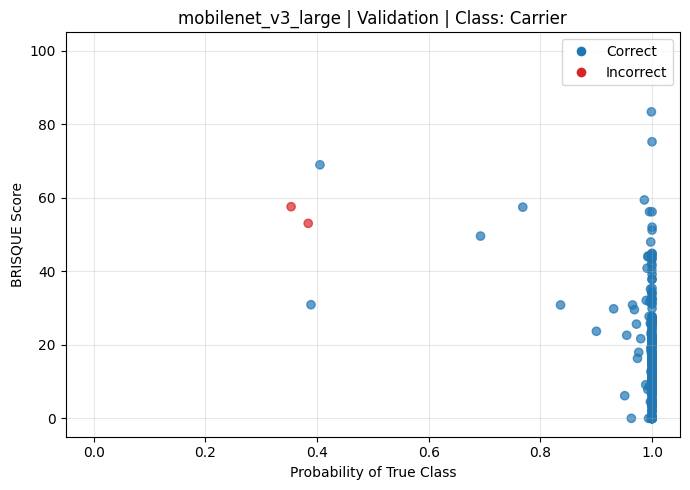

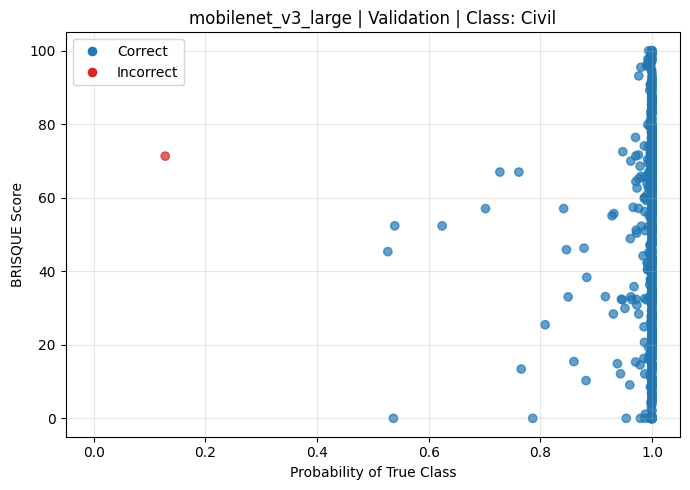

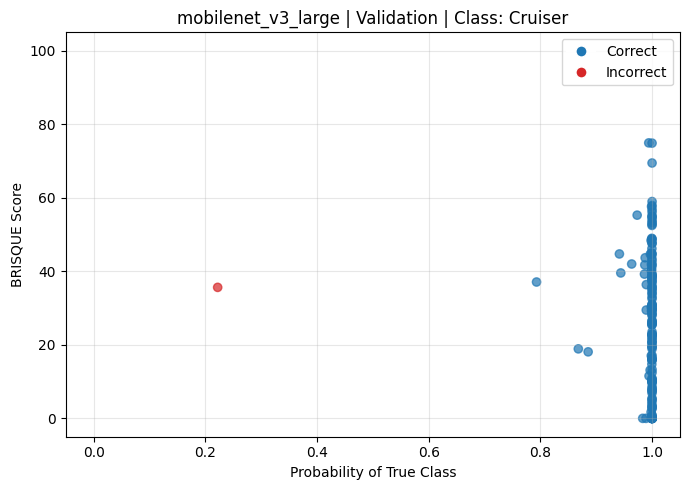

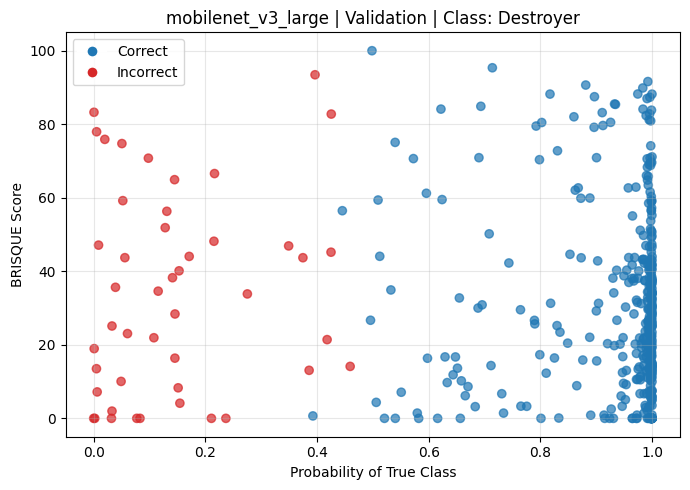

...

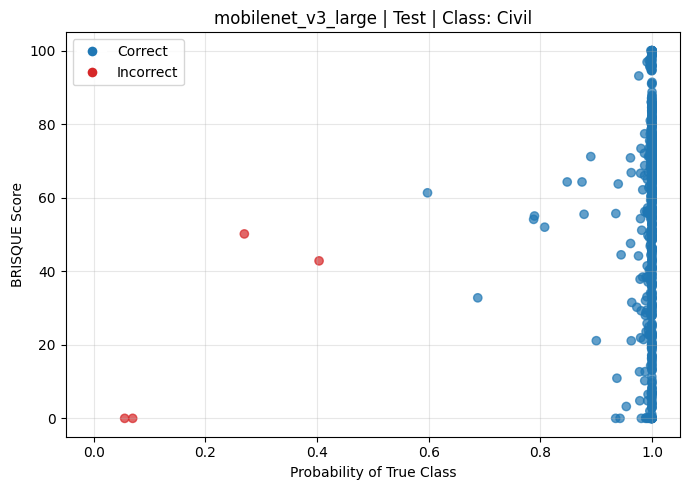

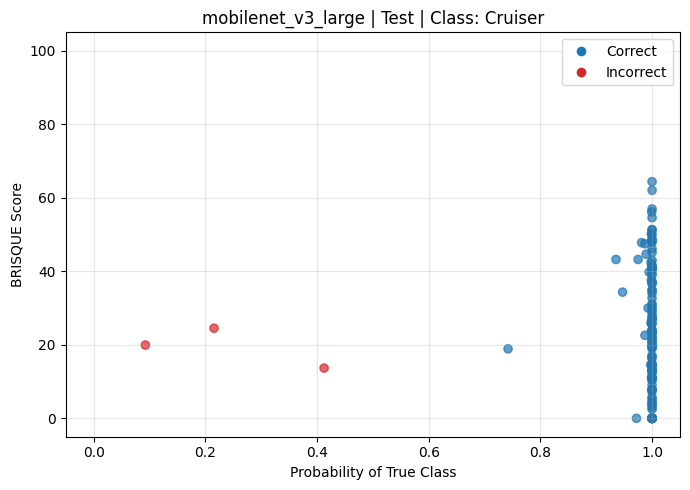

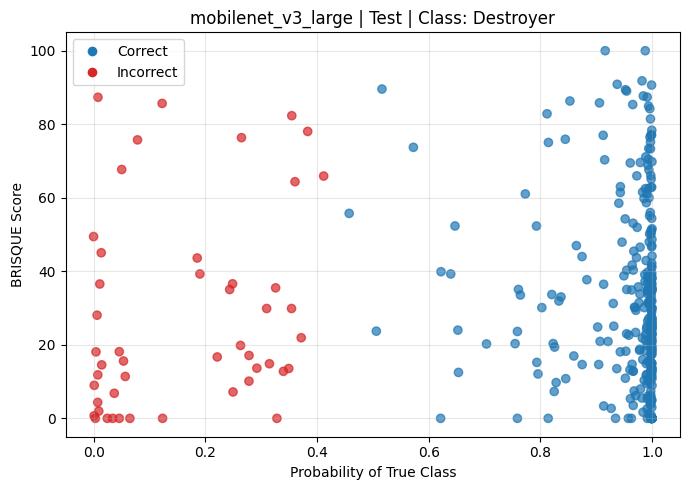

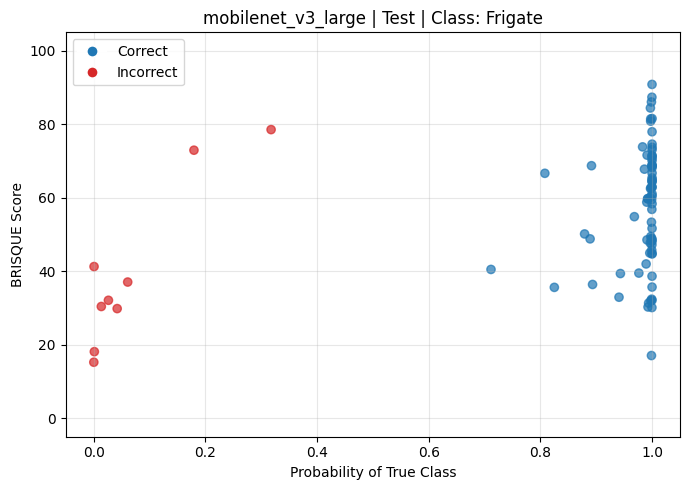

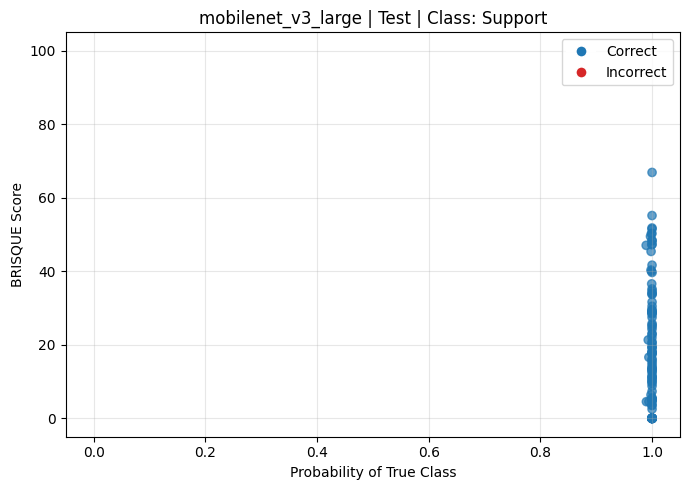

In [131]:
import pandas as pd
import seaborn as sns
import os
from matplotlib.lines import Line2D

import matplotlib.pyplot as plt

# For each model, split, and class, plot: X=true class probability, Y=BRISQUE, color=correct/incorrect
for model_name in model_names:
    for split_title, split_df, split_tag in split_info:
        prob_file = f"{model_name}_{split_tag}_probs.csv"
        if not os.path.exists(prob_file):
            print(f"File not found: {prob_file}")
            continue
        df_probs = pd.read_csv(prob_file)
        # Ensure label is string for mapping
        df_probs['label'] = df_probs['label'].astype(str)
        # Get class index mapping
        label_to_idx = {name: i for i, name in enumerate(split_df['label'].astype('category').cat.categories)}
        # Get true class index for each row
        df_probs['true_idx'] = df_probs['label'].map(label_to_idx)
        # Get predicted class index
        prob_cols = [c for c in df_probs.columns if c.startswith("prob_")]
        df_probs['pred_idx'] = df_probs[prob_cols].values.argmax(axis=1)
        # Correct or not
        df_probs['correct'] = df_probs['pred_idx'] == df_probs['true_idx']
        # Get probability of true class for each row
        true_probs = []
        for idx, row in df_probs.iterrows():
            class_idx = row['true_idx']
            prob_col = prob_cols[class_idx]
            true_probs.append(row[prob_col])
        df_probs['true_prob'] = true_probs
        # For each class, plot
        for class_name, class_idx in label_to_idx.items():
            class_df = df_probs[df_probs['true_idx'] == class_idx]
            plt.figure(figsize=(7,5))
            scatter = plt.scatter(
                class_df['true_prob'],
                class_df['brisque'],
                c=class_df['correct'].map({True: 'tab:blue', False: 'tab:red'}),
                alpha=0.7,
                label=None
            )
            # Add legend manually
            legend_elements = [
                Line2D([0], [0], marker='o', color='w', label='Correct', markerfacecolor='tab:blue', markersize=8),
                Line2D([0], [0], marker='o', color='w', label='Incorrect', markerfacecolor='tab:red', markersize=8)
            ]
            plt.legend(handles=legend_elements)
            plt.xlabel("Probability of True Class")
            plt.ylabel("BRISQUE Score")
            plt.title(f"{model_name} | {split_title} | Class: {class_name}")
            plt.grid(True, alpha=0.3)
            plt.xlim(-0.05, 1.05)
            plt.ylim(-5, 105)  # Assuming BRISQUE scores are in the range [0, 100]
            plt.tight_layout()
            plt.show()

# 9. Experiments

In [148]:
import numpy as np
import cv2

def filter_anomalies(img: np.ndarray, pixel_diff: float = 0.25) -> np.ndarray:
    """
    Eq. (1), Sec. 3.1: four-neighbor average + relative-difference threshold.
    Vectorized via a single 2D convolution.
    """
    # img assumed float32 in [0,1]
    kernel = np.array([[0,1,0],
                       [1,0,1],
                       [0,1,0]], dtype=np.float32) * 0.25
    mu = cv2.filter2D(img, -1, kernel, borderType=cv2.BORDER_REFLECT)
    rel = np.abs(img - mu) / (mu + 1e-6)
    out = img.copy()
    out[rel > pixel_diff] = mu[rel > pixel_diff]
    return out

def low_high_mask(img: np.ndarray, low: float = 0.0, high: float = 1.0) -> np.ndarray:
    """
    Eq. (2), Sec. 3.1: binary mask of intensities in (low, high).
    """
    return ((img > low) & (img < high)).astype(np.float32)

def compute_gradients(img: np.ndarray,
                      mask: np.ndarray = None,
                      ksize: int = 5
                     ) -> (np.ndarray, np.ndarray):
    """
    Eqs. (3)–(4), Sec. 3.2: multiply by mask *before* Sobel.
    """
    if mask is not None:
        img = img * mask
    gx = cv2.Sobel(img, cv2.CV_32F, 1, 0, ksize=ksize)
    gy = cv2.Sobel(img, cv2.CV_32F, 0, 1, ksize=ksize)
    return gx, gy

def select_gradients(g: np.ndarray, pl: float, pu: float) -> np.ndarray:
    """
    Eq. (5)–(6), Sec. 3.2: percentile selection on |g|.
    """
    a = np.abs(g)
    valid = a > 0
    if valid.sum() < 5:
        return np.zeros_like(g)
    lo, hi = np.percentile(a[valid], [pl, pu])
    mask = (a >= lo) & (a <= hi)
    return g * mask

def sharpness_and_representativeness(
    img_rgb: np.ndarray,
    sobel_ksize: int = 5,
    gauss_ksize: int = 5,
    gauss_sigma: float = 1.0,
    pl: float = 98.5,
    pu: float = 99.5,
    pixel_diff: float = 0.25,
    low_high: tuple = (0.0, 1.0),
    rep_scale: int = 3,
    rep_sigma: float = 5.0
) -> tuple:
    """
    Implements Antonel et al.’s Algorithm 1 (Sec. 3).
    Returns (Sx, Sy, Rx, Ry).
    """
    # grayscale 0–1
    gray = cv2.cvtColor(img_rgb, cv2.COLOR_RGB2GRAY).astype(np.float32) / 255.0

    # 1) anomaly filtering
    img_filt = filter_anomalies(gray, pixel_diff)

    # 2) low/high mask
    mlh = low_high_mask(img_filt, *low_high)

    # 3–4) gradients + select on (img×mlh)
    gx, gy = compute_gradients(img_filt, mask=mlh, ksize=sobel_ksize)
    sgx = select_gradients(gx, pl, pu)
    sgy = select_gradients(gy, pl, pu)

    # 5) blurred base = (img×mlh) * G(σ)
    base = img_filt * mlh
    blur = cv2.GaussianBlur(base, (gauss_ksize, gauss_ksize), gauss_sigma)

    # 6–7) gradients + select on blurred
    bgx, bgy = compute_gradients(blur, mask=mlh, ksize=sobel_ksize)
    sbgx = select_gradients(bgx, pl, pu)
    sbgy = select_gradients(bgy, pl, pu)

    # 8) delta gradients
    vx = np.abs(sgx) > 0
    vy = np.abs(sgy) > 0
    dGx = np.zeros_like(sgx)
    dGy = np.zeros_like(sgy)
    dGx[vx] = (np.abs(sgx[vx]) - np.abs(sbgx[vx])) / (np.abs(sgx[vx]) + 1e-6)
    dGy[vy] = (np.abs(sgy[vy]) - np.abs(sbgy[vy])) / (np.abs(sgy[vy]) + 1e-6)

    # 9) Sx, Sy (sharpness)
    Sx = 100. * dGx[vx].mean() if vx.any() else np.nan
    Sy = 100. * dGy[vy].mean() if vy.any() else np.nan

    # 10) representativeness blur (3× kernel, σ=5)
    rks = rep_scale * gauss_ksize
    rb = cv2.GaussianBlur(img_filt, (rks, rks), rep_sigma)

    # 11) gradients + select on rep-blurred
    rgx, rgy = compute_gradients(rb, mask=mlh, ksize=sobel_ksize)
    srgx = select_gradients(rgx, pl, pu)
    srgy = select_gradients(rgy, pl, pu)

    # 12) Rx, Ry (representativeness)
    Rx = np.abs(srgx).mean() if srgx.size else np.nan
    Ry = np.abs(srgy).mean() if srgy.size else np.nan

    # return Sx, Sy, Rx, Ry
    return (Sx + Sy) / 2  # if you just want a single sharpness score

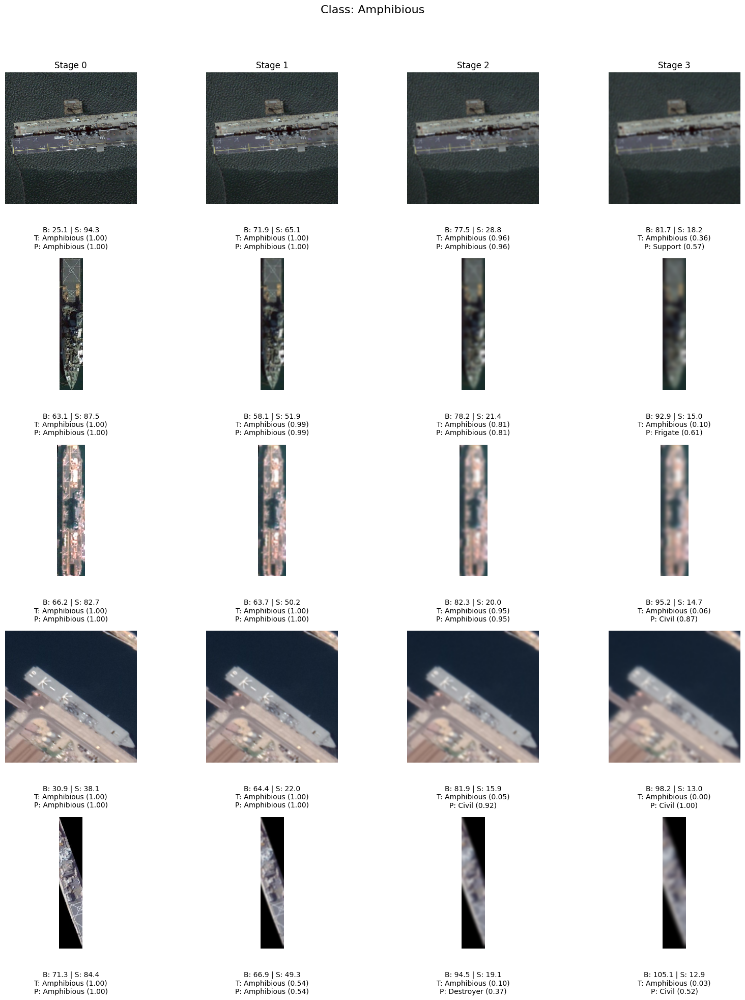

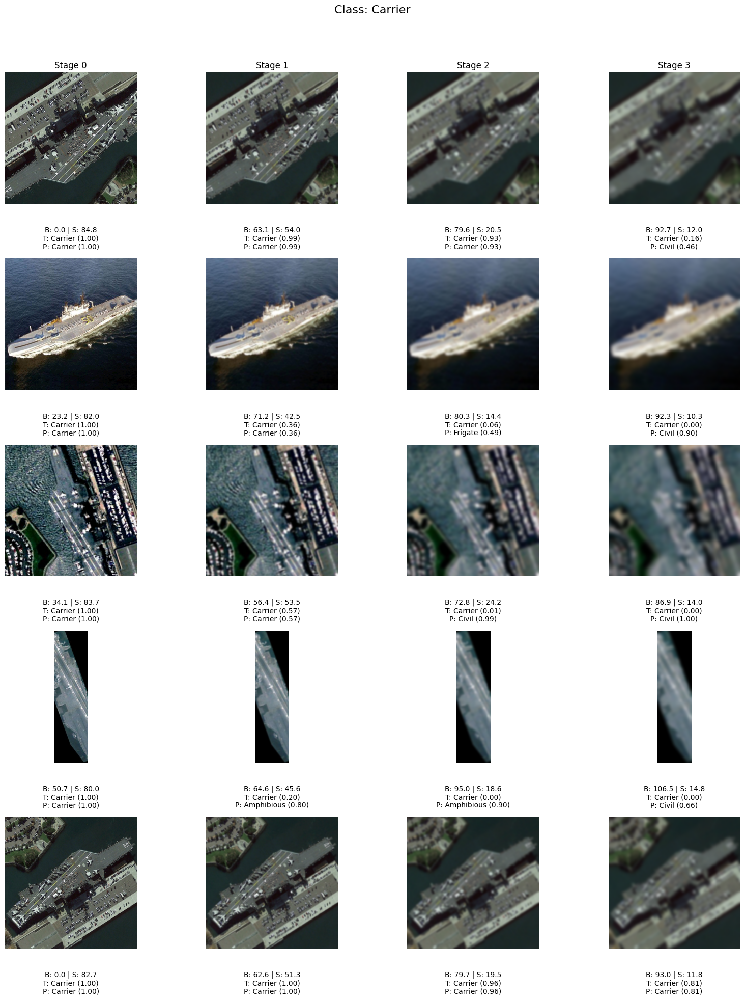

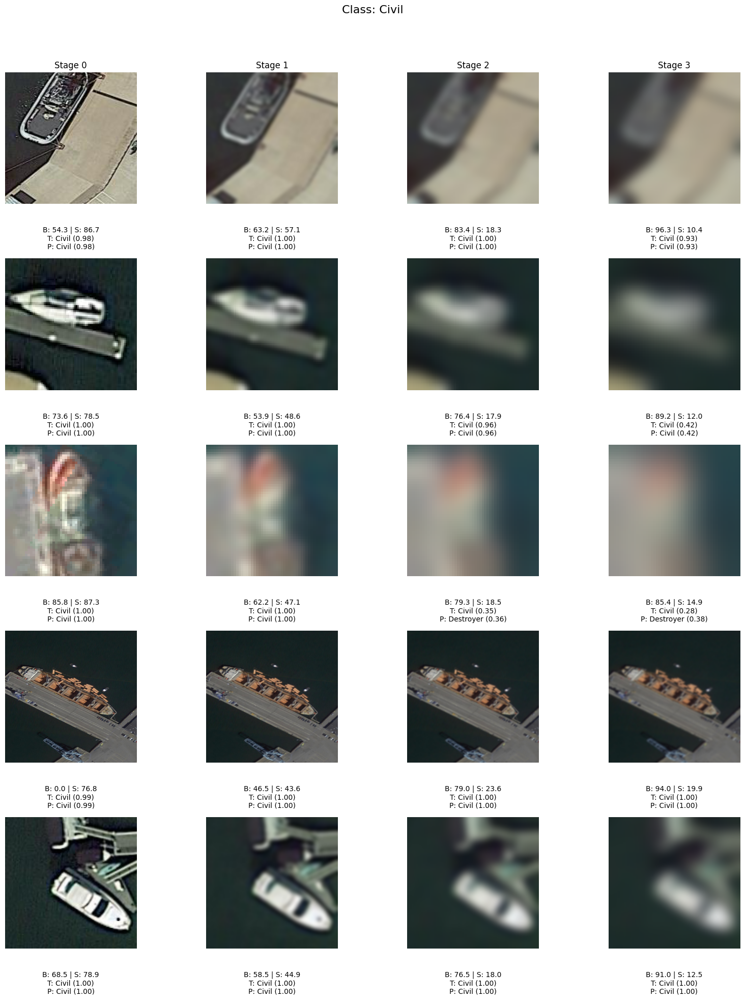

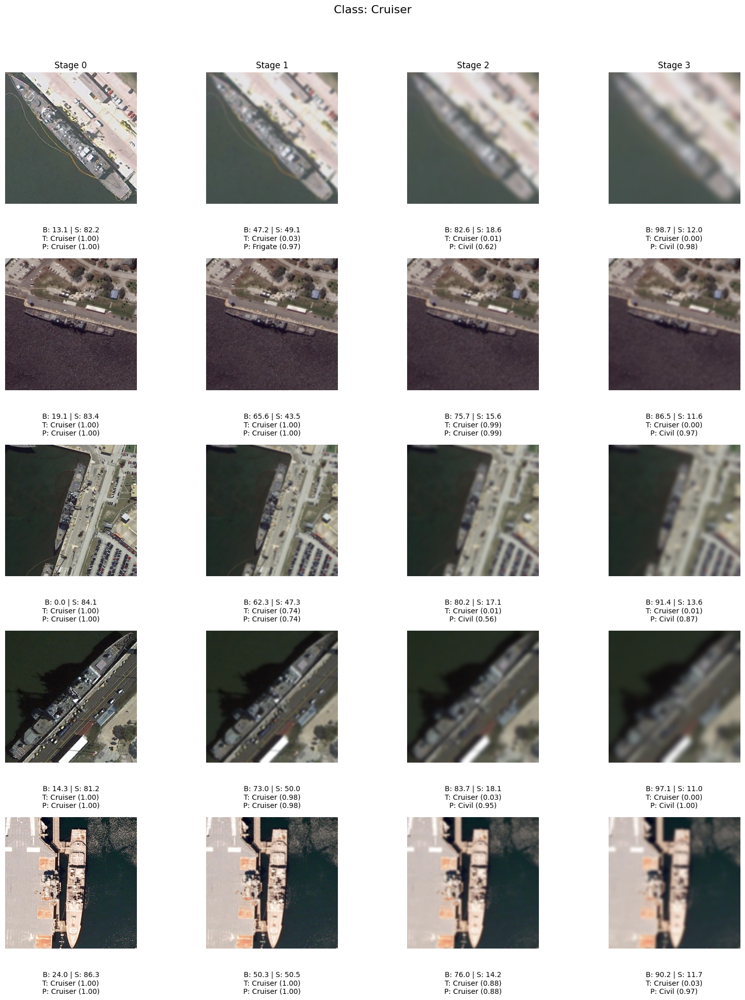

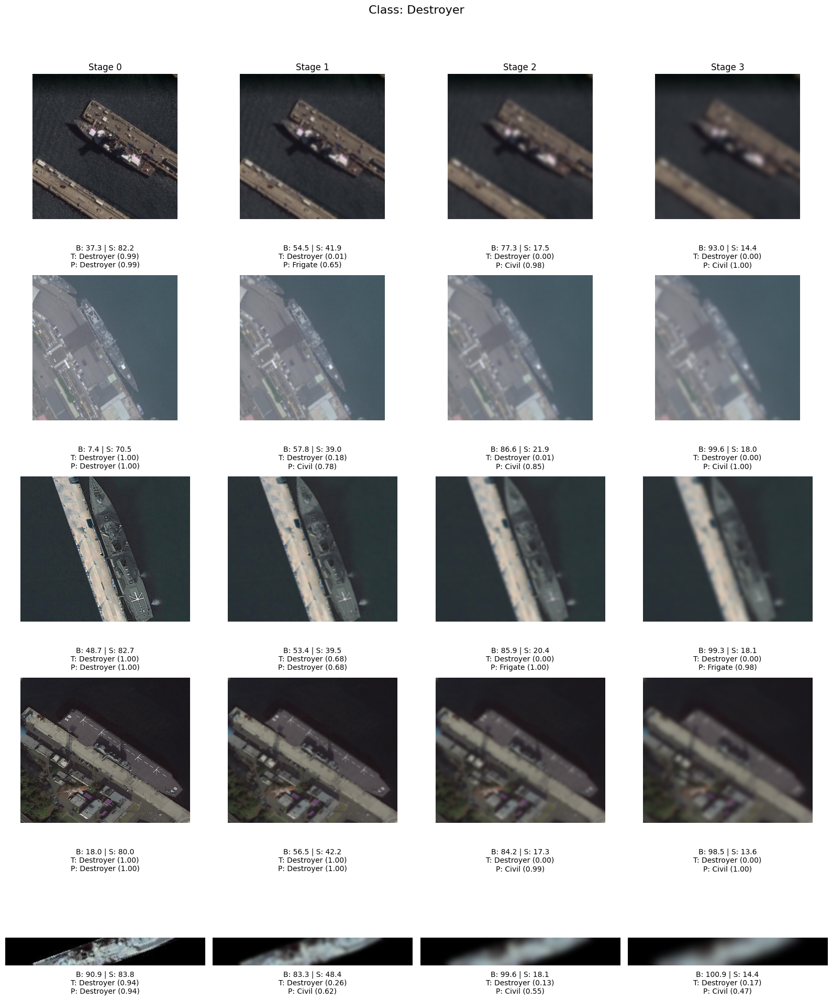

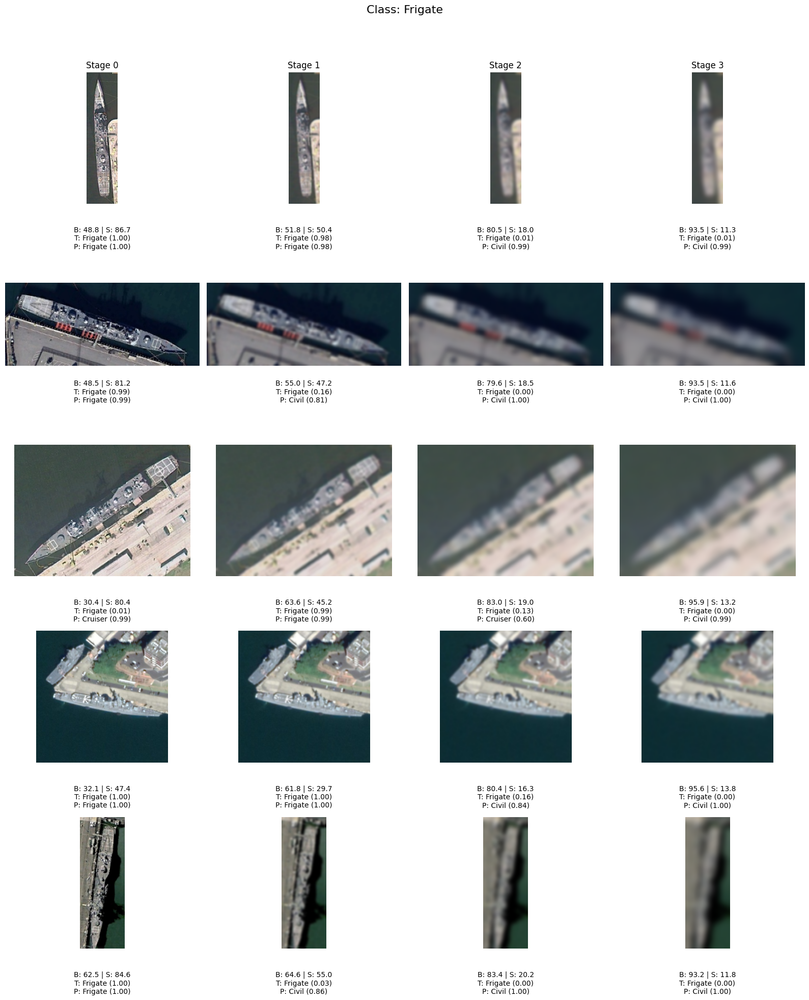

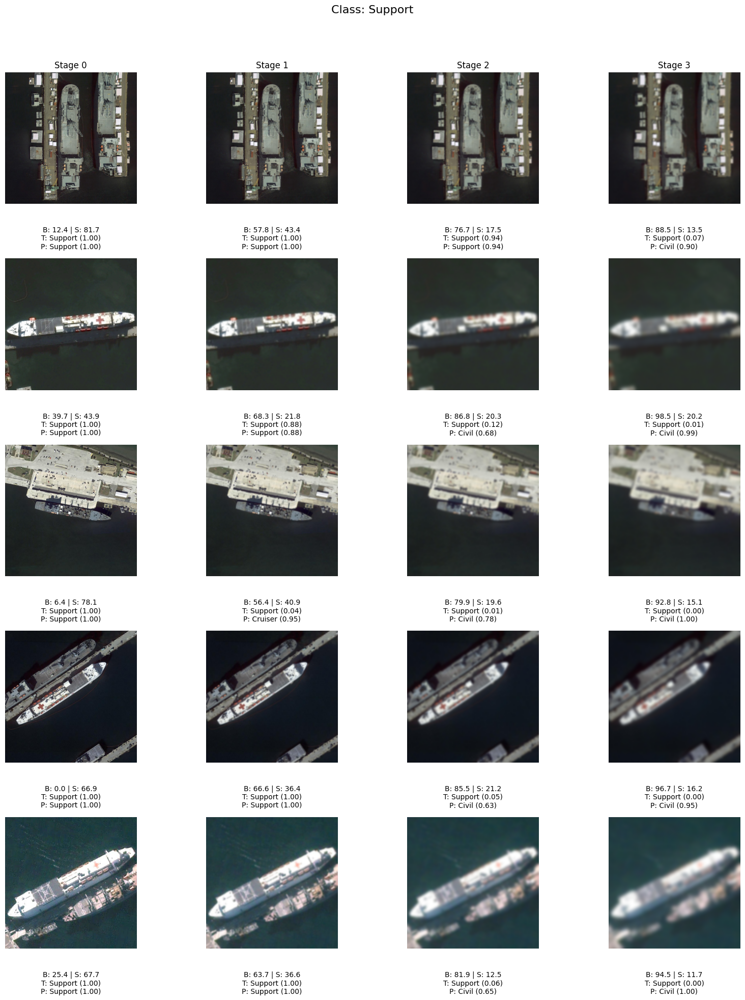

In [151]:
import random
from PIL import Image, ImageFilter
import matplotlib.pyplot as plt
import numpy as np

def degrade_image(img, stage):
    if stage == 0:
        return img
    img = img.copy()
    # Apply progressively stronger Gaussian blur
    img = img.filter(ImageFilter.GaussianBlur(radius=2*stage))
    return img

def show_images_predictions_per_class(
    model, df, label_names, imgs_per_class=5, stages=4, brisque_func=None, device="cpu"):
    random.seed(42)
    for class_name in label_names:
        subset = df[df['label'] == class_name]
        selected = subset.sample(min(imgs_per_class, len(subset)), random_state=42)
        indices = selected.index.tolist()

        fig, axes = plt.subplots(len(indices), stages, figsize=(4*stages, 4*len(indices)))
        if len(indices) == 1:
            axes = np.expand_dims(axes, axis=0)

        model.eval()
        for row_idx, df_idx in enumerate(indices):
            img_orig = Image.open(df.loc[df_idx, 'img_path']).convert('RGB')
            brisque_orig = df.loc[df_idx, 'brisque']
            for stage in range(stages):
                img = degrade_image(img_orig, stage)
                img_tensor = eval_transform(img).unsqueeze(0).to(device)
                np_img = np.array(img)

                # Compute metrics
                br = brisque_orig if stage == 0 else brisque_func(np_img)
                sharp = sharpness_and_representativeness(
                        np_img,
                        sobel_ksize=3,        # detect coarser edges
                        gauss_ksize=9,        # big enough to span the kernel of σ=3
                        gauss_sigma=3.0,      # baseline blur strong enough to kill most high-freq detail
                        pl=85.0,              # include more of the mid-range edges
                        pu=98.0,              # but still ignore the absolute top 2%
                        pixel_diff=0.15,      # a bit more anomaly-filter headroom
                        low_high=(0.0, 1.0),
                        rep_scale=3,
                        rep_sigma=5.0
                    )
                with torch.no_grad():
                    out = model(img_tensor)
                    probs = torch.softmax(out, dim=1).cpu().numpy()[0]
                    pred_idx = np.argmax(probs)
                    pred = label_names[pred_idx]
                    true_class = class_name
                    prob_true = probs[label_names.index(true_class)]
                    prob_pred = probs[pred_idx]

                ax = axes[row_idx, stage]
                ax.imshow(img)
                ax.axis('off')
                subtitle = (
                    f"B: {br:.1f} | S: {sharp:.1f}\n"
                    f"T: {true_class} ({prob_true:.2f})\n"
                    f"P: {pred} ({prob_pred:.2f})"
                )
                if row_idx == 0:
                    ax.set_title(f"Stage {stage}", fontsize=12)
                if stage == 0:
                    ax.set_ylabel(f"Img{row_idx+1}", fontsize=12)
                ax.text(0.5, -0.17, subtitle, fontsize=10, ha='center', va='top', transform=ax.transAxes)

        plt.suptitle(f"Class: {class_name}", fontsize=16)
        plt.tight_layout(rect=[0, 0, 1, 0.95])
        plt.show()

# Example usage:
from brisque.brisque import BRISQUE
brisque_model = BRISQUE(url=False)
def brisque_func(np_img):
    return brisque_model.score(img=np_img)

show_images_predictions_per_class(
    model, test_df, label_names,
    imgs_per_class=5, stages=4, brisque_func=brisque_func, device=device
)

# 9. Defining Quality Bins Based on BRISQUE Scores

We divide the BRISQUE score range [0, 100] into `n_bins` equal-width bins. Each image is assigned to a quality bin according to its BRISQUE score.

In [ ]:
def find_max_bins(df, min_per_class_in_first_bin=1, max_bins=20):
    for n_bins in range(max_bins, 1, -1):  # Try from high to low
        bin_edges = np.linspace(0, 100, n_bins + 1)
        bin_labels = [f'Bin_{i+1}' for i in range(n_bins)]
        bins = pd.cut(df['brisque'], bins=bin_edges, labels=bin_labels, include_lowest=True, right=False)
        df_temp = df.copy()
        df_temp['quality_bin'] = bins
        # Count images per class in first bin
        class_counts_in_first_bin = df_temp[df_temp['quality_bin'] == 'Bin_1']['label'].value_counts()
        enough_in_each = all(class_counts_in_first_bin.get(cls, 0) >= min_per_class_in_first_bin for cls in df['label'].unique())
        if enough_in_each:
            return n_bins, bin_edges, bin_labels
    return None, None, None

In [ ]:
# Run the auto bin finder
# Use only val_df for bin finding
n_bins, bin_edges, bin_labels = find_max_bins(val_df, min_per_class_in_first_bin=10, max_bins=20)
if n_bins is not None:
    print(f"Maximal suitable number of bins for training: {n_bins}")
    print("Bin edges:", bin_edges)
else:
    print("No suitable binning found for the training set.")

In [ ]:
if n_bins is not None:
    train_df['quality_bin'] = pd.cut(
        train_df['brisque'], bins=bin_edges, labels=bin_labels, include_lowest=True, right=False
    )
    val_df['quality_bin'] = pd.cut(
        val_df['brisque'], bins=bin_edges, labels=bin_labels, include_lowest=True, right=False
    )
    test_df['quality_bin'] = pd.cut(
        test_df['brisque'], bins=bin_edges, labels=bin_labels, include_lowest=True, right=False
    )

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

if n_bins is not None:
    # Training set
    plt.figure(figsize=(7,4))
    sns.countplot(x='quality_bin', data=train_df, order=bin_labels, palette="Blues")
    plt.title(f"Train Set: Number of Images per Quality Bin (n_bins={n_bins})")
    plt.xlabel("Quality Bin")
    plt.ylabel("Number of Images")
    plt.show()

    # Validation set
    plt.figure(figsize=(7,4))
    sns.countplot(x='quality_bin', data=val_df, order=bin_labels, palette="Greens")
    plt.title(f"Validation/Calibration Set: Number of Images per Quality Bin (n_bins={n_bins})")
    plt.xlabel("Quality Bin")
    plt.ylabel("Number of Images")
    plt.show()

    # Test set
    plt.figure(figsize=(7,4))
    sns.countplot(x='quality_bin', data=test_df, order=bin_labels, palette="Oranges")
    plt.title(f"Test Set: Number of Images per Quality Bin (n_bins={n_bins})")
    plt.xlabel("Quality Bin")
    plt.ylabel("Number of Images")
    plt.show()
else:
    print("No suitable binning found. Please check your binning parameters.")


In [ ]:
if n_bins is not None:
    for split_name, split_df, cmap in zip(
        ["Train", "Validation", "Test"],
        [train_df, val_df, test_df],
        ["YlGnBu", "BuGn", "Oranges"]
    ):
        heatmap_data = split_df.groupby(['label', 'quality_bin']).size().unstack(fill_value=0)
        plt.figure(figsize=(15,7))
        sns.heatmap(heatmap_data, annot=True, fmt='d', cmap=cmap)
        plt.title(f"{split_name} Set: Images per Superclass and BRISQUE Bin (n_bins={n_bins})")
        plt.xlabel("Quality Bin")
        plt.ylabel("Superclass")
        plt.tight_layout()
        plt.show()


In [ ]:
def check_empty_bins(split_df, split_name="dataset"):
    missing = split_df.groupby(['label', 'quality_bin']).size().unstack(fill_value=0)
    empties = (missing == 0).sum().sum()
    if empties > 0:
        print(f"Warning: {empties} empty (class, bin) pairs in {split_name}.")
    else:
        print(f"No empty (class, bin) pairs in {split_name}.")

check_empty_bins(train_df, "train")
check_empty_bins(test_df, "test")